### Prueba de concepto base
Prueba eliminando la columna repeatactivity dado que es completamente en ceros sin eliminar la columna sharedsubpage con 99.6% ceros.

1. Los valores que tengan una ocurrencia del cero con mayor al 85% se van a transformar a variable binaria, 1 si la variable ha sido utilizada ó 0 si la variable no ha sido utilizada
2. No se hace normalizacion
3. Se discretizan los datos en 5 grupos (cuartelizarlos)
4. Se transforman a variables dummies 
5. Se dividen los datos por periodo 
6. Se balancea la informacion con 2000 datos para cada resultado (Pass, Fail)
7. Se entrena con una proporcion 80-20

### Resultados

### 2013B
              precision    recall  f1-score   support

    0               0.89      0.92      0.90       378
    1               0.93      0.89      0.91       422

    accuracy                            0.91       800
    macro avg       0.91      0.91      0.91       800
    weighted avg    0.91      0.91      0.91       800

### 2013J
                 precision    recall  f1-score   support

    0               0.80      0.85      0.82       378
    1               0.86      0.81      0.83       422

    accuracy                            0.83       800
    macro avg       0.83      0.83      0.83       800
    weighted avg    0.83      0.83      0.83       800

### 2014B
                 precision    recall  f1-score   support

    0              0.82      0.89      0.85       378
    1              0.89      0.82      0.86       422

    accuracy                           0.85       800
    macro avg      0.85      0.86      0.85       800
    weighted avg   0.86      0.85      0.85       800

### 2014J
                 precision    recall  f1-score   support

    0              0.87      0.92      0.90       378
    1              0.93      0.88      0.90       422

    accuracy                           0.90       800
    macro avg      0.90      0.90      0.90       800
    weighted avg   0.90      0.90      0.90       800

In [1]:
import pandas as pd
from pandas_profiling import ProfileReport
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score
from sklearn import tree

In [2]:
df = pd.read_csv('CompleteInfo.csv')

In [4]:
profile = ProfileReport(df, title='Complete info report', html={'style':{'full_width':True }})
profile

### Con que porcentaje de aparicion del cero no tomo en cuenta la variable?

In [4]:
# Por ahora voy a excluir columnas con un porcentaje mayor al 90%  (sujeto a cambiar)
# Hay 6 variables que no cumplen con esta restriccion dejando 17 variables que si
# No se van eliminar las columnas, se mapea a se uso y no se uso {se uso: 1, no se uso: 0}
#df = df.drop(columns = ['sharedsubpage','htmlactivity','ouelluminate','dataplus','repeatactivity','folder'])
listaColumns = ['sharedsubpage','htmlactivity','ouelluminate','dataplus','repeatactivity','folder']
def mapear(x):
    if x > 0:
        return 0
    else:
        return 1
for y in listaColumns:
    df[y].apply(mapear)

In [5]:
df.head()
#df.to_csv('CasiCompleto.csv', index=False)

,code_presentation,url,forumng,homepage,oucontent,subpage,resource,sharedsubpage,page,questionnaire,...,externalquiz,repeatactivity,dualpane,quiz,glossary,oucollaborate,folder,acumneg,acumg,final_result
0,2014J,143,451,497,1505,143,31,0,0,0,...,0,0,0,0,0,0,0,256,2535,Pass
1,2013J,23,36,184,64,227,70,0,0,0,...,12,0,0,0,0,12,0,81,565,Withdrawn
2,2014J,0,2,7,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,10,Withdrawn
3,2013J,5,193,138,553,32,13,0,0,0,...,0,0,0,0,0,0,0,98,836,Pass
4,2013B,0,87,36,0,5,2,0,0,0,...,0,0,0,31,0,0,0,14,147,Fail


In [6]:
#listaColumns = ['sharedsubpage','htmlactivity','ouelluminate','dataplus','repeatactivity','folder']
df.keys()

Index(['code_presentation', 'url', 'forumng', 'homepage', 'oucontent',
       'subpage', 'resource', 'sharedsubpage', 'page', 'questionnaire',
       'ouwiki', 'htmlactivity', 'ouelluminate', 'dataplus', 'externalquiz',
       'repeatactivity', 'dualpane', 'quiz', 'glossary', 'oucollaborate',
       'folder', 'acumneg', 'acumg', 'final_result'],
      dtype='object')

In [7]:
#Se saca el cuartil para cada columna excepto final_result
url = pd.qcut(df.url, 5, labels= False,duplicates = 'drop')
forumng = pd.qcut(df.forumng, 5, labels= False,duplicates = 'drop')
homepage = pd.qcut(df.homepage, 5, labels= False,duplicates = 'drop')
oucontent = pd.qcut(df.oucontent, 5, labels= False,duplicates = 'drop')
subpage = pd.qcut(df.subpage, 5, labels= False,duplicates = 'drop')
resource = pd.qcut(df.resource, 5, labels= False,duplicates = 'drop')

page = pd.qcut(df.page, 5, labels= False,duplicates = 'drop')
questionnaire = pd.qcut(df.questionnaire, 5, labels= False,duplicates = 'drop')
ouwiki = pd.qcut(df.ouwiki, 5, labels= False,duplicates = 'drop')



externalquiz = pd.qcut(df.externalquiz, 5, labels= False,duplicates = 'drop')

dualpane = pd.qcut(df.dualpane, 5, labels= False,duplicates = 'drop')
quiz = pd.qcut(df.quiz, 5, labels= False,duplicates = 'drop')
glossary = pd.qcut(df.glossary, 5, labels= False,duplicates = 'drop')
oucollaborate = pd.qcut(df.oucollaborate, 5, labels= False,duplicates = 'drop')

acumneg = pd.qcut(df.acumneg, 5, labels= False,duplicates = 'drop')
acumg = pd.qcut(df.acumg, 5, labels= False,duplicates = 'drop')


In [8]:
# Se reemplaza el valor con el cuartil
df['url'] = url
df['forumng'] = forumng
df['homepage'] = homepage
df['oucontent'] = oucontent
df['subpage'] = subpage
df['page'] = page
df['questionnaire'] = questionnaire
df['ouwiki'] = ouwiki
df['resource'] = resource
df['externalquiz'] = externalquiz
df['dualpane'] = dualpane
df['quiz'] = quiz
df['glossary'] = glossary
df['oucollaborate'] = oucollaborate
df['acumneg'] = acumneg
df['acumg'] = acumg

In [9]:
df.head()

,code_presentation,url,forumng,homepage,oucontent,subpage,resource,sharedsubpage,page,questionnaire,...,externalquiz,repeatactivity,dualpane,quiz,glossary,oucollaborate,folder,acumneg,acumg,final_result
0,2014J,4,4,4,4,3,2,0,0,0,...,0,0,0,0,0,0,0,4,4,Pass
1,2013J,3,1,2,2,4,4,0,0,0,...,0,0,0,0,0,1,0,3,2,Withdrawn
2,2014J,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Withdrawn
3,2013J,1,3,2,3,1,1,0,0,0,...,0,0,0,0,0,0,0,3,2,Pass
4,2013B,0,2,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,Fail


In [10]:
df.shape

(29228, 24)

In [11]:
#Se junta Distiction y Pass 
mapearDistinction = {'Distinction':'Pass', 'Fail':'Fail','Pass':'Pass','Withdrawn':'Withdrawn'}
df['final_result'] = df['final_result'].map(mapearDistinction)
df

,code_presentation,url,forumng,homepage,oucontent,subpage,resource,sharedsubpage,page,questionnaire,...,externalquiz,repeatactivity,dualpane,quiz,glossary,oucollaborate,folder,acumneg,acumg,final_result
0,2014J,4,4,4,4,3,2,0,0,0,...,0,0,0,0,0,0,0,4,4,Pass
1,2013J,3,1,2,2,4,4,0,0,0,...,0,0,0,0,0,1,0,3,2,Withdrawn
2,2014J,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,Withdrawn
3,2013J,1,3,2,3,1,1,0,0,0,...,0,0,0,0,0,0,0,3,2,Pass
4,2013B,0,2,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,Fail
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29223,2013J,1,3,2,3,2,1,0,0,0,...,0,0,0,0,0,0,0,2,2,Pass
29224,2014B,2,3,1,0,2,2,0,0,0,...,0,0,0,2,0,0,0,2,2,Withdrawn
29225,2013J,4,4,4,4,0,0,0,0,0,...,0,0,0,2,0,0,0,2,4,Pass
29226,2014J,1,2,3,3,2,3,0,0,0,...,0,0,0,1,0,1,0,0,2,Fail


Quitamos los valores de final_result = withdrawn ya que no genera valor con los resultados finales con notas. 

In [12]:
df_filtered = df[df['final_result'] != 'Distinction']
df_filtered.shape

(29228, 24)

In [13]:
df_filtered = df_filtered[df_filtered['final_result'] != 'Withdrawn']
df_filtered.shape

(22060, 24)

In [ ]:
Separar por periodos

In [14]:
df_filtered_2013b = df_filtered[df_filtered['code_presentation'] == '2013B']
df_filtered_2013j = df_filtered[df_filtered['code_presentation'] == '2013J']
df_filtered_2014b = df_filtered[df_filtered['code_presentation'] == '2014B']
df_filtered_2014j = df_filtered[df_filtered['code_presentation'] == '2013B']


In [15]:
#mapeo_final_result = {'Pass': 1, 'Withdrawn': 0, 'Fail': -1}
mapeo_final_result = {'Pass': 1, 'Fail': 0}

df_filtered_2013b['final_result'] = df_filtered['final_result'].map(mapeo_final_result)
df_filtered_2013j['final_result'] = df_filtered['final_result'].map(mapeo_final_result)
df_filtered_2014b['final_result'] = df_filtered['final_result'].map(mapeo_final_result)
df_filtered_2014j['final_result'] = df_filtered['final_result'].map(mapeo_final_result)

df_filtered_2013b.head()

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

,code_presentation,url,forumng,homepage,oucontent,subpage,resource,sharedsubpage,page,questionnaire,...,externalquiz,repeatactivity,dualpane,quiz,glossary,oucollaborate,folder,acumneg,acumg,final_result
4,2013B,0,2,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,0
11,2013B,3,4,4,0,1,2,0,0,0,...,0,0,0,1,1,0,0,1,4,1
42,2013B,4,4,4,0,4,4,0,0,0,...,0,0,0,1,1,0,0,1,3,0
70,2013B,4,4,4,0,4,4,0,0,0,...,0,0,0,1,1,0,0,4,4,1
84,2013B,4,4,4,4,4,3,0,1,0,...,0,0,0,3,0,0,0,4,4,1


In [16]:
print(df_filtered_2013b['final_result'].value_counts())
print(df_filtered_2013j['final_result'].value_counts())
print(df_filtered_2014b['final_result'].value_counts())
print(df_filtered_2014j['final_result'].value_counts())

1    2095
0    1173
Name: final_result, dtype: int64
1    4475
0    1882
Name: final_result, dtype: int64
1    3358
0    1721
Name: final_result, dtype: int64
1    2095
0    1173
Name: final_result, dtype: int64


In [17]:
#Se pasa a variables Dummie
#listaColumns = ['sharedsubpage','htmlactivity','ouelluminate','dataplus','repeatactivity','folder']
df_filtered_dummie_2013b = pd.get_dummies(df_filtered_2013b, columns = [
    'url',
    'forumng',
    'homepage',
    'oucontent',
    'subpage',
    'resource',
    'page',
    'questionnaire',
    'ouwiki',
    'externalquiz',
    'dualpane',
    'quiz',
    'glossary',
    'oucollaborate',
    'acumneg',
    'acumg'
])
df_filtered_dummie_2013j = pd.get_dummies(df_filtered_2013j, columns = [
    'url',
    'forumng',
    'homepage',
    'oucontent',
    'subpage',
    'resource',
    'page',
    'questionnaire',
    'ouwiki',
    'externalquiz',
    'dualpane',
    'quiz',
    'glossary',
    'oucollaborate',
    'acumneg',
    'acumg'
])
df_filtered_dummie_2014b = pd.get_dummies(df_filtered_2014b, columns = [
    'url',
    'forumng',
    'homepage',
    'oucontent',
    'subpage',
    'resource',
    'page',
    'questionnaire',
    'ouwiki',
    'externalquiz',
    'dualpane',
    'quiz',
    'glossary',
    'oucollaborate',
    'acumneg',
    'acumg'
])
df_filtered_dummie_2014j = pd.get_dummies(df_filtered_2014j, columns = [
    'url',
    'forumng',
    'homepage',
    'oucontent',
    'subpage',
    'resource',
    'page',
    'questionnaire',
    'ouwiki',
    'externalquiz',
    'dualpane',
    'quiz',
    'glossary',
    'oucollaborate',
    'acumneg',
    'acumg'
])


df_filtered_dummie_2013b.keys()

Index(['code_presentation', 'sharedsubpage', 'htmlactivity', 'ouelluminate',
       'dataplus', 'repeatactivity', 'folder', 'final_result', 'url_0',
       'url_1', 'url_2', 'url_3', 'url_4', 'forumng_0', 'forumng_1',
       'forumng_2', 'forumng_3', 'forumng_4', 'homepage_0', 'homepage_1',
       'homepage_2', 'homepage_3', 'homepage_4', 'oucontent_0', 'oucontent_1',
       'oucontent_2', 'oucontent_3', 'oucontent_4', 'subpage_0', 'subpage_1',
       'subpage_2', 'subpage_3', 'subpage_4', 'resource_0', 'resource_1',
       'resource_2', 'resource_3', 'resource_4', 'page_0', 'page_1',
       'questionnaire_0', 'ouwiki_0', 'ouwiki_1', 'externalquiz_0',
       'dualpane_0', 'quiz_0', 'quiz_1', 'quiz_2', 'quiz_3', 'glossary_0',
       'glossary_1', 'oucollaborate_0', 'acumneg_0', 'acumneg_1', 'acumneg_2',
       'acumneg_3', 'acumneg_4', 'acumg_0', 'acumg_1', 'acumg_2', 'acumg_3',
       'acumg_4'],
      dtype='object')

In [18]:
#Borrar code_presentation
df_filtered_dummie_2013b = df_filtered_dummie_2013b.drop(columns=['code_presentation'])
df_filtered_dummie_2013j = df_filtered_dummie_2013j.drop(columns=['code_presentation'])
df_filtered_dummie_2014b = df_filtered_dummie_2014b.drop(columns=['code_presentation'])
df_filtered_dummie_2014j = df_filtered_dummie_2014j.drop(columns=['code_presentation'])
df_filtered_dummie_2013b.keys()

Index(['sharedsubpage', 'htmlactivity', 'ouelluminate', 'dataplus',
       'repeatactivity', 'folder', 'final_result', 'url_0', 'url_1', 'url_2',
       'url_3', 'url_4', 'forumng_0', 'forumng_1', 'forumng_2', 'forumng_3',
       'forumng_4', 'homepage_0', 'homepage_1', 'homepage_2', 'homepage_3',
       'homepage_4', 'oucontent_0', 'oucontent_1', 'oucontent_2',
       'oucontent_3', 'oucontent_4', 'subpage_0', 'subpage_1', 'subpage_2',
       'subpage_3', 'subpage_4', 'resource_0', 'resource_1', 'resource_2',
       'resource_3', 'resource_4', 'page_0', 'page_1', 'questionnaire_0',
       'ouwiki_0', 'ouwiki_1', 'externalquiz_0', 'dualpane_0', 'quiz_0',
       'quiz_1', 'quiz_2', 'quiz_3', 'glossary_0', 'glossary_1',
       'oucollaborate_0', 'acumneg_0', 'acumneg_1', 'acumneg_2', 'acumneg_3',
       'acumneg_4', 'acumg_0', 'acumg_1', 'acumg_2', 'acumg_3', 'acumg_4'],
      dtype='object')

In [19]:
df_filtered_dummie_2013b.head()

,sharedsubpage,htmlactivity,ouelluminate,dataplus,repeatactivity,folder,final_result,url_0,url_1,url_2,...,acumneg_0,acumneg_1,acumneg_2,acumneg_3,acumneg_4,acumg_0,acumg_1,acumg_2,acumg_3,acumg_4
4,0,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,1,0,0,0,0
11,0,0,1,0,0,0,1,0,0,0,...,0,1,0,0,0,0,0,0,0,1
42,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
70,0,0,11,0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,1
84,0,0,42,38,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,1


In [20]:
#Se balancea las clases
balanced1_2013b = df_filtered_dummie_2013b.loc[df_filtered_dummie_2013b['final_result'] == 1].sample(2000, random_state=42,replace=True)
balanced0_2013b = df_filtered_dummie_2013b.loc[df_filtered_dummie_2013b['final_result'] == 0].sample(2000, random_state=42,replace=True)

balanced1_2013j = df_filtered_dummie_2013j.loc[df_filtered_dummie_2013j['final_result'] == 1].sample(2000, random_state=42,replace=True)
balanced0_2013j = df_filtered_dummie_2013j.loc[df_filtered_dummie_2013j['final_result'] == 0].sample(2000, random_state=42,replace=True)

balanced1_2014b = df_filtered_dummie_2014b.loc[df_filtered_dummie_2014b['final_result'] == 1].sample(2000, random_state=42,replace=True)
balanced0_2014b = df_filtered_dummie_2014b.loc[df_filtered_dummie_2014b['final_result'] == 0].sample(2000, random_state=42,replace=True)

balanced1_2014j = df_filtered_dummie_2014j.loc[df_filtered_dummie_2014j['final_result'] == 1].sample(2000, random_state=42,replace=True)
balanced0_2014j = df_filtered_dummie_2014j.loc[df_filtered_dummie_2014j['final_result'] == 0].sample(2000, random_state=42,replace=True)

#balanced_1 = df_filtered_dummie.loc[df_filtered_dummie['final_result'] == -1].sample(6000, random_state=42)

In [21]:
#df_filtered_dummie_balanced = pd.concat([balanced0, balanced1, balanced_1])
df_filtered_dummie_balanced_2013b = pd.concat([balanced1_2013b, balanced0_2013b])
df_filtered_dummie_balanced_2013j = pd.concat([balanced1_2013j, balanced0_2013j])
df_filtered_dummie_balanced_2014b = pd.concat([balanced1_2014b, balanced0_2014b])
df_filtered_dummie_balanced_2014j = pd.concat([balanced1_2014j, balanced0_2014j])

In [22]:
#x = df_filtered_dummie_balanced.drop(columns = ['final_result'], axis=1)
#x.shape
x_2013b = df_filtered_dummie_balanced_2013b.drop(columns = ['final_result'], axis=1)
x_2013j = df_filtered_dummie_balanced_2013j.drop(columns = ['final_result'], axis=1)
x_2014b = df_filtered_dummie_balanced_2014b.drop(columns = ['final_result'], axis=1)
x_2014j = df_filtered_dummie_balanced_2014j.drop(columns = ['final_result'], axis=1)
x_2013b.head()

,sharedsubpage,htmlactivity,ouelluminate,dataplus,repeatactivity,folder,url_0,url_1,url_2,url_3,...,acumneg_0,acumneg_1,acumneg_2,acumneg_3,acumneg_4,acumg_0,acumg_1,acumg_2,acumg_3,acumg_4
7828,0,0,26,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0
9707,1,0,0,0,0,0,0,0,1,0,...,0,0,1,0,0,0,0,1,0,0
9066,0,0,4,0,0,0,0,0,0,1,...,0,0,1,0,0,0,0,1,0,0
8949,0,0,60,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
10936,0,0,7,0,0,0,0,0,0,1,...,1,0,0,0,0,0,0,1,0,0


In [23]:
#y = df_filtered_dummie_balanced['final_result']
y_2013b = df_filtered_dummie_balanced_2013b['final_result']
y_2013j = df_filtered_dummie_balanced_2013j['final_result']
y_2014b = df_filtered_dummie_balanced_2014b['final_result']
y_2014j = df_filtered_dummie_balanced_2014j['final_result']
y_2013b.head()

7828     1
9707     1
9066     1
8949     1
10936    1
Name: final_result, dtype: int64

### Hasta aqui van con datos

#### El set de entrenamiento es de 70-30

In [82]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

In [83]:
tree_modelo = tree.DecisionTreeClassifier()

In [84]:
tree_modelo.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [85]:
prediccion = tree_modelo.predict(X_test)

In [86]:
Counter(prediccion)

Counter({1: 1772, 0: 1828})

In [87]:
confusion_matrix(y_test, prediccion)

array([[1281,  546],
       [ 547, 1226]])

In [88]:
print(classification_report(y_test, prediccion))

              precision    recall  f1-score   support

           0       0.70      0.70      0.70      1827
           1       0.69      0.69      0.69      1773

    accuracy                           0.70      3600
   macro avg       0.70      0.70      0.70      3600
weighted avg       0.70      0.70      0.70      3600



In [89]:
score = cross_val_score(tree_modelo, X_train,y_train)
score

array([0.6952381 , 0.71547619, 0.70119048, 0.68035714, 0.71845238])

In [90]:
score.mean()

0.7021428571428571

## Hyperparameters Tuning

### Primero creo que los set de entrenamiento 80-20

In [24]:
X_train_2013b, X_test_2013b, y_train_2013b, y_test_2013b = train_test_split(x_2013b, y_2013b, test_size=0.2, random_state=42)
X_train_2013j, X_test_2013j, y_train_2013j, y_test_2013j = train_test_split(x_2013j, y_2013j, test_size=0.2, random_state=42)
X_train_2014b, X_test_2014b, y_train_2014b, y_test_2014b = train_test_split(x_2014b, y_2014b, test_size=0.2, random_state=42)
X_train_2014j, X_test_2014j, y_train_2014j, y_test_2014j = train_test_split(x_2014j, y_2014j, test_size=0.2, random_state=42)

In [61]:
params_dist = {'max_depth':[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,None],
              'criterion':['gini','entropy']}

In [62]:
tree_modelo_tununig_2013b = tree.DecisionTreeClassifier()
tree_modelo_tununig_2013j = tree.DecisionTreeClassifier()
tree_modelo_tununig_2014b = tree.DecisionTreeClassifier()
tree_modelo_tununig_2014j = tree.DecisionTreeClassifier()

In [63]:
from sklearn.model_selection import RandomizedSearchCV
from random import randint

In [64]:
tree_modelo_tuning_cv_2013b = RandomizedSearchCV(tree_modelo_tununig_2013b, params_dist, cv=100)
tree_modelo_tuning_cv_2013j = RandomizedSearchCV(tree_modelo_tununig_2013j, params_dist, cv=100)
tree_modelo_tuning_cv_2014b = RandomizedSearchCV(tree_modelo_tununig_2014b, params_dist, cv=100)
tree_modelo_tuning_cv_2014j = RandomizedSearchCV(tree_modelo_tununig_2014j, params_dist, cv=100)

In [65]:
tree_modelo_tuning_cv_2013b.fit(X_train_2013b, y_train_2013b)
tree_modelo_tuning_cv_2013j.fit(X_train_2013j, y_train_2013j)
tree_modelo_tuning_cv_2014b.fit(X_train_2014b, y_train_2014b)
tree_modelo_tuning_cv_2014j.fit(X_train_2014j, y_train_2014j)

In [66]:
print("Tuned Decision tree best parameters: {}".format(tree_modelo_tuning_cv_2013b.best_params_))
print("Best score is {}".format(tree_modelo_tuning_cv_2013b.best_score_))

print("Tuned Decision tree best parameters: {}".format(tree_modelo_tuning_cv_2013j.best_params_))
print("Best score is {}".format(tree_modelo_tuning_cv_2013j.best_score_))

print("Tuned Decision tree best parameters: {}".format(tree_modelo_tuning_cv_2014b.best_params_))
print("Best score is {}".format(tree_modelo_tuning_cv_2014b.best_score_))

print("Tuned Decision tree best parameters: {}".format(tree_modelo_tuning_cv_2014j.best_params_))
print("Best score is {}".format(tree_modelo_tuning_cv_2014j.best_score_))

Tuned Decision tree best parameters: {'max_depth': 19, 'criterion': 'gini'}
Best score is 0.8915625
Tuned Decision tree best parameters: {'max_depth': 19, 'criterion': 'entropy'}
Best score is 0.8590625
Tuned Decision tree best parameters: {'max_depth': None, 'criterion': 'gini'}
Best score is 0.8578125
Tuned Decision tree best parameters: {'max_depth': 19, 'criterion': 'gini'}
Best score is 0.89


In [67]:
y_predict_cv_2013b = tree_modelo_tuning_cv_2013b.predict(X_test_2013b)
y_predict_cv_2013j = tree_modelo_tuning_cv_2013j.predict(X_test_2013j)
y_predict_cv_2014b = tree_modelo_tuning_cv_2014b.predict(X_test_2014b)
y_predict_cv_2014j = tree_modelo_tuning_cv_2014j.predict(X_test_2014j)

In [68]:
confusion_matrix_cv_2013b = confusion_matrix(y_test_2013b, y_predict_cv_2013b)
print(confusion_matrix_cv_2013b)

confusion_matrix_cv_2013j = confusion_matrix(y_test_2013j, y_predict_cv_2013j)
print(confusion_matrix_cv_2013j)

confusion_matrix_cv_2014b = confusion_matrix(y_test_2014b, y_predict_cv_2014b)
print(confusion_matrix_cv_2014b)

confusion_matrix_cv_2014j = confusion_matrix(y_test_2014j, y_predict_cv_2014j)
print(confusion_matrix_cv_2014j)

[[348  30]
 [ 45 377]]
[[322  56]
 [ 81 341]]
[[336  42]
 [ 75 347]]
[[348  30]
 [ 51 371]]


In [69]:
print(classification_report(y_test_2013b, y_predict_cv_2013b))
print(classification_report(y_test_2013j, y_predict_cv_2013j))
print(classification_report(y_test_2014b, y_predict_cv_2014b))
print(classification_report(y_test_2014j, y_predict_cv_2014j))

              precision    recall  f1-score   support

           0       0.89      0.92      0.90       378
           1       0.93      0.89      0.91       422

    accuracy                           0.91       800
   macro avg       0.91      0.91      0.91       800
weighted avg       0.91      0.91      0.91       800

              precision    recall  f1-score   support

           0       0.80      0.85      0.82       378
           1       0.86      0.81      0.83       422

    accuracy                           0.83       800
   macro avg       0.83      0.83      0.83       800
weighted avg       0.83      0.83      0.83       800

              precision    recall  f1-score   support

           0       0.82      0.89      0.85       378
           1       0.89      0.82      0.86       422

    accuracy                           0.85       800
   macro avg       0.85      0.86      0.85       800
weighted avg       0.86      0.85      0.85       800

              preci

### Con los parametros mejores parametros se procede a crear los arboles y entrenarlos
#### Luego de esto se procede a mostrar el arbol

In [70]:
#tree.plot_tree(tree_2013b)
#tree.export_graphviz(tree_modelo_tununig_2013b)
tree_2013b = tree.DecisionTreeClassifier(max_depth=19, criterion='gini')
tree_2013j = tree.DecisionTreeClassifier(max_depth=19, criterion='entropy')
tree_2014b = tree.DecisionTreeClassifier(max_depth=None, criterion='gini')
tree_2014j = tree.DecisionTreeClassifier(max_depth=19, criterion='gini')

In [71]:
tree_2013b.fit(X_train_2013b, y_train_2013b)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=19, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [72]:
tree_2014b.fit(X_train_2014b, y_train_2014b)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [73]:
tree_2013j.fit(X_train_2013j, y_train_2013j)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=19, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [74]:
tree_2014j.fit(X_train_2014j, y_train_2014j)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=19, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [79]:
import matplotlib.pyplot as plt

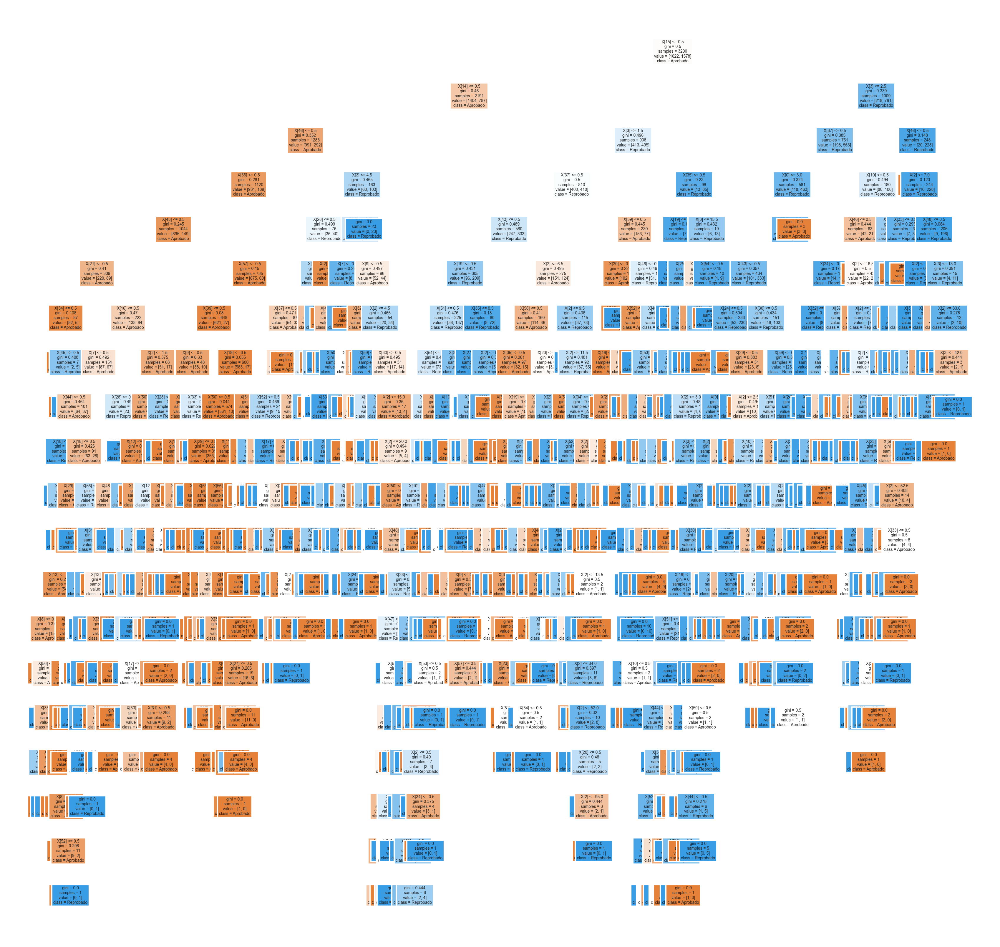

In [83]:
#tree.export_graphviz(tree_2013b)

fn=['sepal length (cm)','sepal width (cm)','petal length (cm)','petal width (cm)']
cn=['Aprobado', 'Reprobado']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=1000)
tree.plot_tree(tree_2013b, class_names=cn, filled = True);

fig.savefig('tree_2013b.jpg')